In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

In [0]:
from pyspark.sql.types import StructType, StructField, IntegerType, StringType, DoubleType

# Define schema for application_df
application_schema = StructType([
    StructField("ID", IntegerType(), True),
    StructField("CODE_GENDER", StringType(), True),
    StructField("FLAG_OWN_CAR", StringType(), True),
    StructField("FLAG_OWN_REALTY", StringType(), True),
    StructField("CNT_CHILDREN", IntegerType(), True),
    StructField("AMT_INCOME_TOTAL", DoubleType(), True),
    StructField("NAME_INCOME_TYPE", StringType(), True),
    StructField("NAME_EDUCATION_TYPE", StringType(), True),
    StructField("NAME_FAMILY_STATUS", StringType(), True),
    StructField("NAME_HOUSING_TYPE", StringType(), True),
    StructField("DAYS_BIRTH", IntegerType(), True),
    StructField("DAYS_EMPLOYED", IntegerType(), True),
    StructField("FLAG_MOBIL", IntegerType(), True),
    StructField("FLAG_WORK_PHONE", IntegerType(), True),
    StructField("FLAG_PHONE", IntegerType(), True),
    StructField("FLAG_EMAIL", IntegerType(), True),
    StructField("OCCUPATION_TYPE", StringType(), True),
    StructField("CNT_FAM_MEMBERS", DoubleType(), True)
])

# Define schema for credit_df
credit_schema = StructType([
    StructField("ID", IntegerType(), True),
    StructField("MONTHS_BALANCE", IntegerType(), True),
    StructField("STATUS", StringType(), True)
])

credit_df = (spark.read
              .option("header", True)
              .csv("dbfs:/FileStore/shared_uploads/ayushbajracharya09@gmail.com/credit_record.csv", schema=credit_schema))

application_df = (spark.read
              .option("header", True)
              .csv("dbfs:/FileStore/shared_uploads/ayushbajracharya09@gmail.com/application_record.csv", schema=application_schema))


In [0]:
from pyspark.sql import functions as F

# Find the minimum 'MONTHS_BALANCE' for each ID (account open month)
begin_month = (credit_df.groupBy("ID")
               .agg(F.min("MONTHS_BALANCE").alias("MONTHS_BALANCE"), 
                    F.first("STATUS").alias("STATUS")))

# Merge the calculated 'begin_month' and 'STATUS' with the 'application_df'
merged_df = application_df.join(begin_month, on="ID", how="inner")

# Show the result
display(merged_df)


ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,MONTHS_BALANCE,STATUS
5008847,M,Y,Y,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,-20502,-4450,1,0,1,0,Drivers,2.0,-46,C
5009429,M,N,N,0,198000.0,Working,Secondary / secondary special,Single / not married,With parents,-8657,-1164,1,1,0,0,Laborers,1.0,-2,0
5009639,F,N,N,0,90000.0,Pensioner,Secondary / secondary special,Married,House / apartment,-21426,365243,1,0,1,0,null,2.0,-39,C
5009925,M,Y,Y,0,360000.0,Working,Higher education,Married,House / apartment,-19958,-7465,1,0,0,0,Laborers,2.0,-5,0
5010809,F,N,Y,1,135000.0,Working,Higher education,Married,House / apartment,-13833,-617,1,0,0,0,Accountants,3.0,-2,X
5010926,F,Y,Y,2,270000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,-12745,-525,1,0,0,1,Core staff,4.0,-30,C
5018423,F,N,Y,0,202500.0,Commercial associate,Secondary / secondary special,Married,Municipal apartment,-18817,-1094,1,0,0,0,Laborers,2.0,-30,0
5021465,F,Y,Y,1,166500.0,Working,Higher education,Married,House / apartment,-11782,-705,1,0,0,0,Core staff,3.0,-8,0
5022018,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,House / apartment,-9952,-1613,1,0,0,0,null,1.0,-24,X
5022047,M,Y,Y,0,135000.0,Working,Secondary / secondary special,Married,Office apartment,-14917,-8157,1,1,1,0,Drivers,2.0,-25,C


In [0]:
# Define the label_status function
def label_status(status):
    if status in {"0", "1", "2", "3", "4", "5"}:
        return 'bad'
    elif status == 'C':
        return 'good'
    else:
        return None

# Register the function as a UDF
label_status_udf = udf(label_status, StringType())

# Apply the UDF to create a new column 'LABEL'
merged_df = merged_df.withColumn("LABEL", label_status_udf(F.col("STATUS")))

# Drop rows with NULL values in the LABEL column
merged_df = merged_df.dropna(subset=['LABEL'])

# Calculate value counts normalized (relative frequencies) using groupBy
label_counts = merged_df.groupBy("LABEL").count()
total_count = merged_df.count()
label_counts = label_counts.withColumn("normalized_count", label_counts["count"] / total_count)

# Show the normalized value counts
display(label_counts)

LABEL,count,normalized_count
good,17950,0.6700761535015679
bad,8838,0.32992384649843215


In [0]:
from pyspark.sql.functions import when

# Assign binary target: 0 for bad, 1 for good
merged_df = merged_df.withColumn(
    "TARGET", 
    when(merged_df["LABEL"] == "bad", 0).otherwise(1)
)

# Drop the 'MODE_STATUS' and 'LABEL' columns
merged_df = merged_df.drop("MODE_STATUS", "LABEL")

# Show the resulting DataFrame
display(merged_df)

ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,MONTHS_BALANCE,STATUS,TARGET
5008847,M,Y,Y,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,-20502,-4450,1,0,1,0,Drivers,2.0,-46,C,1
5009429,M,N,N,0,198000.0,Working,Secondary / secondary special,Single / not married,With parents,-8657,-1164,1,1,0,0,Laborers,1.0,-2,0,0
5009639,F,N,N,0,90000.0,Pensioner,Secondary / secondary special,Married,House / apartment,-21426,365243,1,0,1,0,null,2.0,-39,C,1
5009925,M,Y,Y,0,360000.0,Working,Higher education,Married,House / apartment,-19958,-7465,1,0,0,0,Laborers,2.0,-5,0,0
5010926,F,Y,Y,2,270000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,-12745,-525,1,0,0,1,Core staff,4.0,-30,C,1
5018423,F,N,Y,0,202500.0,Commercial associate,Secondary / secondary special,Married,Municipal apartment,-18817,-1094,1,0,0,0,Laborers,2.0,-30,0,0
5021465,F,Y,Y,1,166500.0,Working,Higher education,Married,House / apartment,-11782,-705,1,0,0,0,Core staff,3.0,-8,0,0
5022047,M,Y,Y,0,135000.0,Working,Secondary / secondary special,Married,Office apartment,-14917,-8157,1,1,1,0,Drivers,2.0,-25,C,1
5022228,F,N,Y,1,54000.0,Working,Secondary / secondary special,Married,House / apartment,-15581,-187,1,0,0,0,null,3.0,-6,C,1
5022754,F,N,N,1,202500.0,Commercial associate,Secondary / secondary special,Separated,House / apartment,-10800,-3166,1,0,0,0,Sales staff,2.0,-40,C,1


In [0]:
from pyspark.sql import functions as F
from pyspark.sql.types import IntegerType

# Compute AGE from DAYS_BIRTH
merged_df = merged_df.withColumn("AGE", F.floor(F.abs(merged_df["DAYS_BIRTH"]) / 365))

# Calculate credit history length by finding the difference between max and min MONTHS_BALANCE for each ID
credit_history_length = (credit_df.groupBy("ID")
                         .agg((F.max("MONTHS_BALANCE") - F.min("MONTHS_BALANCE")).alias("CREDIT_HISTORY_LENGTH")))

# Merge credit history length with merged_df
merged_df = merged_df.join(credit_history_length, on="ID", how="left")

# Determine if there's recent activity within the last 6 months
def recent_activity_udf(months_balance):
    return 1 if any(month >= -6 for month in months_balance) else 0

# Register UDF
recent_activity_udf = F.udf(recent_activity_udf, IntegerType())

# Apply the UDF to create the RECENT_ACTIVITY column
recent_activity_flag = (credit_df.groupBy("ID")
                        .agg(F.collect_list("MONTHS_BALANCE").alias("MONTHS_BALANCE"))
                        .withColumn("RECENT_ACTIVITY", recent_activity_udf("MONTHS_BALANCE")))

# Merge recent activity flag with merged_df
merged_df = merged_df.join(recent_activity_flag.select("ID", "RECENT_ACTIVITY"), on="ID", how="left")

# Handle DAYS_EMPLOYED and create YEARS_EMPLOYED
threshold = 50 * 365  # 50 years in days
merged_df = merged_df.withColumn("DAYS_EMPLOYED", F.when(merged_df["DAYS_EMPLOYED"] >= threshold, 0).otherwise(merged_df["DAYS_EMPLOYED"]))
merged_df = merged_df.withColumn("YEARS_EMPLOYED", F.floor(F.abs(merged_df["DAYS_EMPLOYED"]) / 365))

# Drop unnecessary columns
merged_df = merged_df.drop("DAYS_BIRTH", "DAYS_EMPLOYED")

# Show the result
display(merged_df)

ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,MONTHS_BALANCE,STATUS,TARGET,AGE,CREDIT_HISTORY_LENGTH,RECENT_ACTIVITY,YEARS_EMPLOYED
5008847,M,Y,Y,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,1,0,1,0,Drivers,2.0,-46,C,1,56,32,0,12
5009429,M,N,N,0,198000.0,Working,Secondary / secondary special,Single / not married,With parents,1,1,0,0,Laborers,1.0,-2,0,0,23,2,1,3
5009639,F,N,N,0,90000.0,Pensioner,Secondary / secondary special,Married,House / apartment,1,0,1,0,null,2.0,-39,C,1,58,39,1,0
5009925,M,Y,Y,0,360000.0,Working,Higher education,Married,House / apartment,1,0,0,0,Laborers,2.0,-5,0,0,54,5,1,20
5010926,F,Y,Y,2,270000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,1,0,0,1,Core staff,4.0,-30,C,1,34,16,0,1
5018423,F,N,Y,0,202500.0,Commercial associate,Secondary / secondary special,Married,Municipal apartment,1,0,0,0,Laborers,2.0,-30,0,0,51,27,1,2
5021465,F,Y,Y,1,166500.0,Working,Higher education,Married,House / apartment,1,0,0,0,Core staff,3.0,-8,0,0,32,8,1,1
5022047,M,Y,Y,0,135000.0,Working,Secondary / secondary special,Married,Office apartment,1,1,1,0,Drivers,2.0,-25,C,1,40,25,1,22
5022228,F,N,Y,1,54000.0,Working,Secondary / secondary special,Married,House / apartment,1,0,0,0,null,3.0,-6,C,1,42,6,1,0
5022754,F,N,N,1,202500.0,Commercial associate,Secondary / secondary special,Separated,House / apartment,1,0,0,0,Sales staff,2.0,-40,C,1,29,28,0,8


In [0]:
# Drop rows with NULL values in the OCCUPATION_TYPE column
merged_df = merged_df.dropna(subset=['OCCUPATION_TYPE'])

# Grouping lower-skill jobs into 'labor_work'
labor_jobs = ['Cleaning staff', 'Cooking staff', 'Drivers', 'Laborers', 
              'Low-skill Laborers', 'Security staff', 'Waiters/barmen staff']
merged_df = merged_df.withColumn(
    "OCCUPATION_TYPE",
    F.when(F.col("OCCUPATION_TYPE").isin(labor_jobs), "laborwork")
    .otherwise(F.col("OCCUPATION_TYPE"))
)

# Grouping office-related jobs into 'office_work'
office_jobs = ['Accountants', 'Core staff', 'HR staff', 'Medicine staff', 
               'Private service staff', 'Realty agents', 'Sales staff', 'Secretaries']
merged_df = merged_df.withColumn(
    "OCCUPATION_TYPE",
    F.when(F.col("OCCUPATION_TYPE").isin(office_jobs), "office_work")
    .otherwise(F.col("OCCUPATION_TYPE"))
)

# Grouping high-tech and managerial jobs into 'high_tech_work'
high_tech_jobs = ['Managers', 'High skill tech staff', 'IT staff']
merged_df = merged_df.withColumn(
    "OCCUPATION_TYPE",
    F.when(F.col("OCCUPATION_TYPE").isin(high_tech_jobs), "high_tech_work")
    .otherwise(F.col("OCCUPATION_TYPE"))
)

# Show the value counts for the 'OCCUPATION_TYPE' column
occupation_counts = merged_df.groupBy("OCCUPATION_TYPE").count().withColumn(
    "normalized_count", F.col("count") / merged_df.count()
)

display(occupation_counts)

OCCUPATION_TYPE,count,normalized_count
office_work,7410,0.4019528071602929
laborwork,7777,0.4218605912666124
high_tech_work,3248,0.17618660157309465


In [0]:
merged_df = merged_df.drop('FLAG_MOBIL', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL')

In [0]:
def drop_low_frequency_categories(df, column_name, threshold=50):
    """
    This function computes the frequency counts of categories in a specified column,
    and identifies the categories with frequency below the given threshold.

    Args:
    column_name (str): The column name for which to compute the frequency counts.
    threshold (int): The frequency threshold for categorizing low-frequency categories (default is 50).

    Returns:
    dataframe: The dataframe with dropped categories that have frequencies below the threshold.
    """
    # Frequency counts
    category_counts = df.groupBy(column_name).count()
    
    # Show the frequency counts (optional)
    display(category_counts)

    # Identify categories with frequency below the threshold
    outliers = category_counts.filter(F.col('count') < threshold).select(column_name).rdd.flatMap(lambda x: x).collect()

    # Show the outlier categories
    print(f"\nNumber of outlier categories (frequency < {threshold}): {len(outliers)}")

    # Filter out rows with rare categories
    df = df.filter(~F.col(column_name).isin(outliers))
    
    return df


In [0]:
merged_df = drop_low_frequency_categories(merged_df, 'CNT_CHILDREN', 100)
merged_df = drop_low_frequency_categories(merged_df, 'CNT_FAM_MEMBERS', 100)
merged_df = drop_low_frequency_categories(merged_df, 'YEARS_EMPLOYED', 50)
merged_df = drop_low_frequency_categories(merged_df, 'AMT_INCOME_TOTAL', 100)

CNT_CHILDREN,count
7,2
3,230
4,40
14,3
0,11759
5,10
2,2011
19,1
1,4379



Number of outlier categories (frequency < 100): 5


CNT_FAM_MEMBERS,count
4.0,1912
2.0,9399
5.0,220
3.0,3723
1.0,3125



Number of outlier categories (frequency < 100): 0


YEARS_EMPLOYED,count
27,69
34,13
8,1139
29,46
38,9
39,10
6,1262
32,35
4,1792
24,56



Number of outlier categories (frequency < 50): 15


AMT_INCOME_TOTAL,count
288000.0,6
58500.0,18
45000.0,41
202500.0,1080
126000.0,273
787500.0,3
427500.0,29
261000.0,53
652500.0,7
139500.0,72



Number of outlier categories (frequency < 100): 158


In [0]:
# 1. Log Transformation
merged_df = merged_df.withColumn("LOG_INCOME", F.log1p(F.col("AMT_INCOME_TOTAL")))

# 2. Binning (Age Grouping)
age_bins = [0, 30, 40, 50, 60, 100]
age_labels = ['<30', '30-40', '40-50', '50-60', '>60']

# Use `when` to create a column for age groups
merged_df = merged_df.withColumn(
    "AGE_GROUP",
    F.when(F.col("AGE") < 30, "<30")
    .when((F.col("AGE") >= 30) & (F.col("AGE") < 40), "30-40")
    .when((F.col("AGE") >= 40) & (F.col("AGE") < 50), "40-50")
    .when((F.col("AGE") >= 50) & (F.col("AGE") < 60), "50-60")
    .otherwise(">60")
)

# 3. Derived Features
merged_df = merged_df.withColumn(
    "INCOME_PER_YEAR", F.col("AMT_INCOME_TOTAL") / F.col("AGE")
)

merged_df = merged_df.withColumn(
    "INCOME_PER_YEAR_FAMILY_MEMBER", F.col("AMT_INCOME_TOTAL") / (F.col("CNT_FAM_MEMBERS") + 1)
)

merged_df = merged_df.withColumn(
    "DEPENDENCY_RATIO", F.col("CNT_CHILDREN") / (F.col("CNT_FAM_MEMBERS") + 1)
)

# 4. Feature Grouping
merged_df = merged_df.withColumn(
    "TOTAL_INCOME_ACTIVITY_RATIO", F.col("AMT_INCOME_TOTAL") / (F.col("RECENT_ACTIVITY") + 1)
)

# Show the result
display(merged_df)


ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,CNT_FAM_MEMBERS,MONTHS_BALANCE,STATUS,TARGET,AGE,CREDIT_HISTORY_LENGTH,RECENT_ACTIVITY,YEARS_EMPLOYED,LOG_INCOME,AGE_GROUP,INCOME_PER_YEAR,INCOME_PER_YEAR_FAMILY_MEMBER,DEPENDENCY_RATIO,TOTAL_INCOME_ACTIVITY_RATIO
5008847,M,Y,Y,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,laborwork,2.0,-46,C,1,56,32,0,12,11.630717389475995,50-60,2008.9285714285713,37500.0,0.0,112500.0
5009925,M,Y,Y,0,360000.0,Working,Higher education,Married,House / apartment,laborwork,2.0,-5,0,0,54,5,1,20,12.793862088206213,50-60,6666.666666666667,120000.0,0.0,180000.0
5010926,F,Y,Y,2,270000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,office_work,4.0,-30,C,1,34,16,0,1,12.506180941677357,30-40,7941.176470588235,54000.0,0.4,270000.0
5018423,F,N,Y,0,202500.0,Commercial associate,Secondary / secondary special,Married,Municipal apartment,laborwork,2.0,-30,0,0,51,27,1,2,12.218500103788143,50-60,3970.5882352941176,67500.0,0.0,101250.0
5022047,M,Y,Y,0,135000.0,Working,Secondary / secondary special,Married,Office apartment,laborwork,2.0,-25,C,1,40,25,1,22,11.813037464800539,40-50,3375.0,45000.0,0.0,67500.0
5022754,F,N,N,1,202500.0,Commercial associate,Secondary / secondary special,Separated,House / apartment,office_work,2.0,-40,C,1,29,28,0,8,12.218500103788143,<30,6982.758620689655,67500.0,0.3333333333333333,202500.0
5022863,F,Y,Y,2,225000.0,Commercial associate,Higher education,Married,House / apartment,office_work,4.0,-5,0,0,38,5,1,9,12.323860125621126,30-40,5921.0526315789475,45000.0,0.4,112500.0
5023011,M,Y,N,0,360000.0,Working,Secondary / secondary special,Married,House / apartment,office_work,2.0,-45,C,1,31,36,0,6,12.793862088206213,30-40,11612.90322580645,120000.0,0.0,360000.0
5023401,F,N,Y,0,99000.0,Commercial associate,Secondary / secondary special,Widow,House / apartment,laborwork,1.0,-10,C,1,59,10,1,3,11.502885230075814,50-60,1677.9661016949153,49500.0,0.0,49500.0
5024693,M,N,Y,0,135000.0,Working,Secondary / secondary special,Married,With parents,laborwork,2.0,-12,C,1,42,12,1,21,11.813037464800539,40-50,3214.285714285714,45000.0,0.0,67500.0


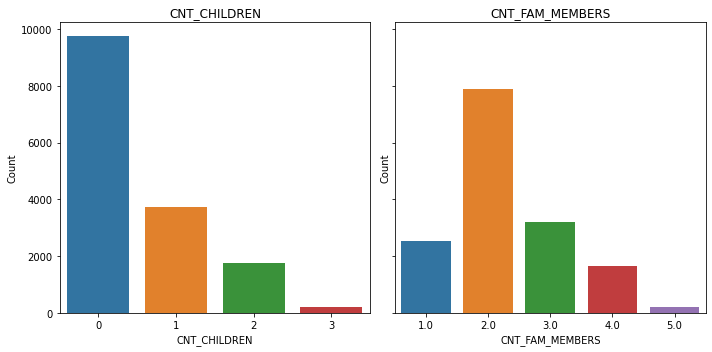

In [0]:
# List of categorical variables to plot
variables = ['CNT_CHILDREN', 'CNT_FAM_MEMBERS']

# Create subplots
fig, axes = plt.subplots(1, len(variables), figsize=(10, 5), sharey=True)

# Iterate through variables and create count plots
for i, var in enumerate(variables):
    # Get the count of each category in the variable
    category_counts = merged_df.groupBy(var).count().toPandas()
    
    # Plot using seaborn countplot style
    sns.barplot(x=var, y='count', data=category_counts, ax=axes[i])
    axes[i].set_title(f"{var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("Count")

plt.tight_layout()
plt.show()

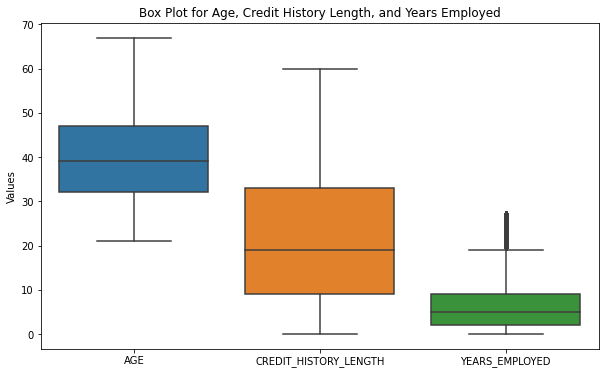

In [0]:
# Select the necessary columns from the merged DataFrame and convert to Pandas
columns_to_plot = ['AGE', 'CREDIT_HISTORY_LENGTH', 'YEARS_EMPLOYED']
pandas_df = merged_df.select(*columns_to_plot).toPandas()

# Create box plot
plt.figure(figsize=(10, 6))
sns.boxplot(data=pandas_df)
plt.title("Box Plot for Age, Credit History Length, and Years Employed")
plt.ylabel("Values")
plt.show()

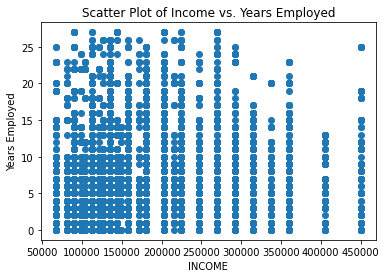

In [0]:
# Convert PySpark DataFrame to Pandas DataFrame for plotting
merged_df_pd = merged_df.select("AMT_INCOME_TOTAL", "YEARS_EMPLOYED").toPandas()

# Scatter plot using Matplotlib
plt.scatter(merged_df_pd['AMT_INCOME_TOTAL'], merged_df_pd['YEARS_EMPLOYED'])
plt.title("Scatter Plot of Income vs. Years Employed")
plt.xlabel("INCOME")
plt.ylabel("Years Employed")
plt.show()


# MODELS

In [0]:
df = merged_df

In [0]:
# Split the DataFrame into training and testing sets (70% training, 30% testing)
train_df, test_df = df.randomSplit([0.7, 0.3], seed=42)

In [0]:
from pyspark.ml.feature import StringIndexer, VectorAssembler, StandardScaler, OneHotEncoder
from pyspark.ml.classification import LogisticRegression, DecisionTreeClassifier, RandomForestClassifier, GBTClassifier
from pyspark.ml import Pipeline

# List of categorical columns that need encoding
categorical_cols = ['AGE_GROUP', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE',
                    'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE']

# List of numerical columns
numerical_cols = ['AMT_INCOME_TOTAL', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'CREDIT_HISTORY_LENGTH', 
                  'RECENT_ACTIVITY', 'YEARS_EMPLOYED', 'INCOME_PER_YEAR', 'INCOME_PER_YEAR_FAMILY_MEMBER', 'DEPENDENCY_RATIO', 'TOTAL_INCOME_ACTIVITY_RATIO']

# 1. StringIndexer: Convert categorical variables to numeric indices
indexers = [
    StringIndexer(inputCol=col, outputCol=col + '_indexed', handleInvalid="keep") 
    for col in categorical_cols
]

# 2. OneHotEncoder: Convert indexed categorical variables to one-hot encoded vectors
encoders = [
    OneHotEncoder(inputCol=col + '_indexed', outputCol=col + '_encoded', handleInvalid="keep") 
    for col in categorical_cols
]

# 3. VectorAssembler: Combine all features (encoded categorical + numerical) into a single feature vector
assembler = VectorAssembler(
    inputCols=[col + '_encoded' for col in categorical_cols] + numerical_cols,
    outputCol='features'
)

# 4. StandardScaler: Scale the combined feature vector
scaler = StandardScaler(inputCol='features', outputCol='scaled_features')

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
from pyspark.mllib.evaluation import MulticlassMetrics
from pyspark.sql.functions import col
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator

def evaluate_model(predictions, label_col="TARGET", prediction_col="prediction"):
    # Cast the prediction column to DoubleType if it is not already
    predictions = predictions.withColumn(prediction_col, col(prediction_col).cast("double"))
    predictions = predictions.withColumn(label_col, col(label_col).cast("double"))

    # 1. ROC AUC Score
    roc_auc_evaluator = BinaryClassificationEvaluator(labelCol=label_col, metricName="areaUnderROC")
    roc_auc = roc_auc_evaluator.evaluate(predictions)
    
    # 2. Accuracy
    accuracy_evaluator = MulticlassClassificationEvaluator(labelCol=label_col, metricName="accuracy")
    accuracy = accuracy_evaluator.evaluate(predictions)
    
    # 3. Precision
    precision_evaluator = MulticlassClassificationEvaluator(labelCol=label_col, metricName="weightedPrecision")
    precision = precision_evaluator.evaluate(predictions)
    
    # 4. Recall
    recall_evaluator = MulticlassClassificationEvaluator(labelCol=label_col, metricName="weightedRecall")
    recall = recall_evaluator.evaluate(predictions)
    
    # 5. F1 Score
    f1_evaluator = MulticlassClassificationEvaluator(labelCol=label_col, metricName="f1")
    f1_score = f1_evaluator.evaluate(predictions)
    
    # 6. Average Precision-Recall (PR AUC)
    avg_precision_evaluator = BinaryClassificationEvaluator(labelCol=label_col, metricName="areaUnderPR")
    avg_precision = avg_precision_evaluator.evaluate(predictions)
    
    # 7. Confusion Matrix
    prediction_and_labels = predictions.select(label_col, prediction_col).rdd
    metrics = MulticlassMetrics(prediction_and_labels)
    conf_matrix = metrics.confusionMatrix().toArray()

    # Print out all metrics
    print(f"ROC AUC Score: {roc_auc:.3f}")
    print(f"Accuracy: {accuracy:.3f}")
    print(f"Precision: {precision:.3f}")
    print(f"Recall: {recall:.3f}")
    print(f"F1 Score: {f1_score:.3f}")
    print(f"Average Precision-Recall: {avg_precision:.3f}")
    print("Confusion Matrix:")
    print(conf_matrix)

In [0]:
spark.conf.set("spark.sql.shuffle.partitions", "256")

In [0]:
# Logistic Regression model
logreg = LogisticRegression(featuresCol='scaled_features', labelCol='TARGET', maxIter=1000)

# Create a pipeline with all stages
lr_pipeline = Pipeline(stages=indexers + encoders + [assembler, scaler, logreg])

# Fit the model on the training data
logreg_model = lr_pipeline.fit(train_df)

# Make predictions on the test set
predictions = logreg_model.transform(test_df)

display(evaluate_model(predictions))

/databricks/spark/python/pyspark/sql/context.py:165: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


ROC AUC Score: 0.819
Accuracy: 0.781
Precision: 0.776
Recall: 0.781
F1 Score: 0.777
Average Precision-Recall: 0.878
Confusion Matrix:
[[ 940.  406.]
 [ 588. 2597.]]


In [0]:
# Decision Tree Classifier model
dt = DecisionTreeClassifier(featuresCol='scaled_features', labelCol='TARGET')

# Create a pipeline with all stages
dt_pipeline = Pipeline(stages=indexers + encoders + [assembler, scaler, dt])

# Fit the model on the training data
dt_model = dt_pipeline.fit(train_df)

# Make predictions on the test set
predictions = dt_model.transform(test_df)

display(evaluate_model(predictions))

ROC AUC Score: 0.747
Accuracy: 0.785
Precision: 0.779
Recall: 0.785
F1 Score: 0.779
Average Precision-Recall: 0.811
Confusion Matrix:
[[ 906.  353.]
 [ 622. 2650.]]


In [0]:
# Random Forest Classifier model
rf = RandomForestClassifier(featuresCol='scaled_features', labelCol='TARGET', numTrees=250, maxDepth=12)

# Create a pipeline with all stages
rf_pipeline = Pipeline(stages=indexers + encoders + [assembler, scaler, rf])

# Fit the model on the training data
rf_model = rf_pipeline.fit(train_df)

# Make predictions on the test set
predictions = rf_model.transform(test_df)

display(evaluate_model(predictions))

ROC AUC Score: 0.854
Accuracy: 0.806
Precision: 0.803
Recall: 0.806
F1 Score: 0.798
Average Precision-Recall: 0.906
Confusion Matrix:
[[ 911.  263.]
 [ 617. 2740.]]


In [0]:
# Gradient Boosting Classifier model (GBT)
gbt = GBTClassifier(featuresCol='scaled_features', labelCol='TARGET', maxIter=25)

# Create a pipeline with all stages
gbt_pipeline = Pipeline(stages=indexers + encoders + [assembler, scaler, gbt])

# Fit the model on the training data
gbt_model = gbt_pipeline.fit(train_df)

# Make predictions on the test set
predictions = gbt_model.transform(test_df)

display(evaluate_model(predictions))

ROC AUC Score: 0.824
Accuracy: 0.785
Precision: 0.780
Recall: 0.785
F1 Score: 0.777
Average Precision-Recall: 0.882
Confusion Matrix:
[[ 871.  317.]
 [ 657. 2686.]]


In [0]:
from pyspark.ml.classification import MultilayerPerceptronClassifier

# Define the MLP architecture
# The first layer has the number of features (categorical + numerical), second layer has 128 neurons, and third layer has 64 neurons
layers = [len(categorical_cols) + len(numerical_cols), 32, 2]

# Initialize MLP Classifier
mlp = MultilayerPerceptronClassifier(
    labelCol="TARGET",
    featuresCol="scaled_features",
    maxIter=150,
    layers=layers,
    blockSize=64,
    stepSize=0.03,
    tol=1e-6
)

# Combine all steps into a pipeline
mlp_pipeline = Pipeline(stages=indexers + encoders + [assembler, scaler, mlp])

# Fit the model on the training data
mlp_model = mlp_pipeline.fit(train_df)

# Make predictions on the test set
predictions = mlp_model.transform(test_df)

In [0]:
spark.conf.set("spark.sql.shuffle.partitions", "256")

# Create a parameter grid for Logistic Regression
paramGrid = ParamGridBuilder() \
    .addGrid(logreg.elasticNetParam, [0.0, 0.5]) \
    .addGrid(logreg.maxIter, [50, 100]) \
    .build()

# Define evaluator
evaluator = BinaryClassificationEvaluator(labelCol="TARGET", metricName="areaUnderROC")

# Set up cross-validation
cv = CrossValidator(
    estimator=lr_pipeline,  # Pipeline includes Logistic Regression
    estimatorParamMaps=paramGrid,
    evaluator=evaluator,
    numFolds=3,  # 3-fold cross-validation
    parallelism=4  # Parallelism for faster processing
)

# Train with cross-validation
cvModel = cv.fit(train_df)

# Get best model and evaluate using the custom evaluation function
bestModel = cvModel.bestModel
predictions = bestModel.transform(test_df)

java.net.NoRouteToHostException: No route to host
	at java.base/sun.nio.ch.SocketChannelImpl.checkConnect(Native Method)
	at java.base/sun.nio.ch.SocketChannelImpl.finishConnect(SocketChannelImpl.java:777)
	at shaded.v9_4.org.eclipse.jetty.io.SelectorManager.doFinishConnect(SelectorManager.java:355)
	at shaded.v9_4.org.eclipse.jetty.io.ManagedSelector.processConnect(ManagedSelector.java:347)
	at shaded.v9_4.org.eclipse.jetty.io.ManagedSelector.access$1700(ManagedSelector.java:65)
	at shaded.v9_4.org.eclipse.jetty.io.ManagedSelector$SelectorProducer.processSelected(ManagedSelector.java:676)
	at shaded.v9_4.org.eclipse.jetty.io.ManagedSelector$SelectorProducer.produce(ManagedSelector.java:535)
	at shaded.v9_4.org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.produceTask(EatWhatYouKill.java:362)
	at shaded.v9_4.org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.doProduce(EatWhatYouKill.java:186)
	at shaded.v9_4.org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.tryProduce(EatWhatYouKill.java:173)
	at shaded.v9_4.org.eclipse.jetty.util.thread.strategy.EatWhatYouKill.run(EatWhatYouKill.java:131)
	at shaded.v9_4.org.eclipse.jetty.util.thread.ReservedThreadExecutor$ReservedThread.run(ReservedThreadExecutor.java:409)
	at com.databricks.rpc.ShadedInstrumentedQueuedThreadPool$$anon$2.$anonfun$run$4(InstrumentedQueuedThreadPool.scala:183)
	at scala.runtime.java8.JFunction0$mcV$sp.apply(JFunction0$mcV$sp.java:23)
	at com.databricks.logging.AttributionContextTracing.$anonfun$withAttributionContext$1(AttributionContextTracing.scala:48)
	at com.databricks.logging.AttributionContext$.$anonfun$withValue$1(AttributionContext.scala:271)
	at scala.util.DynamicVariable.withValue(DynamicVariable.scala:62)
	at com.databricks.logging.AttributionContext$.withValue(AttributionContext.scala:267)
	at com.databricks.logging.AttributionContextTracing.withAttributionContext(AttributionContextTracing.scala:46)
	at com.databricks.logging.AttributionContextTracing.withAttributionContext$(AttributionContextTracing.scala:43)
	at com.databricks.rpc.ShadedInstrumentedQueuedThreadPool.withAttributionContext(InstrumentedQueuedThreadPool.scala:130)
	at com.databricks.rpc.ShadedInstrumentedQueuedThreadPool$$anon$2.$anonfun$run$3(InstrumentedQueuedThreadPool.scala:183)
	at scala.runtime.java8.JFunction0$mcV$sp.apply(JFunction0$mcV$sp.java:23)
	at com.databricks.instrumentation.QueuedThreadPoolInstrumenter.trackActiveThreads(QueuedThreadPoolInstrumenter.scala:126)
	at com.databricks.instrumentation.QueuedThreadPoolInstrumenter.trackActiveThreads$(QueuedThreadPoolInstrumenter.scala:123)
	at com.databricks.rpc.ShadedInstrumentedQueuedThreadPool.trackActiveThreads(InstrumentedQueuedThreadPool.scala:130)
	at com.databricks.rpc.ShadedInstrumentedQueuedThreadPool$$anon$2.run(InstrumentedQueuedThreadPool.scala:177)
	at shaded.v9_4.org.eclipse.jetty.util.thread.QueuedThreadPool.runJob(QueuedThreadPool.java:883)
	at shaded.v9_4.org.eclipse.jetty.util.thread.QueuedThreadPool$Runner.run(QueuedThreadPool.java:1034)
	at java.base/java.lang.Thread.run(Thread.java:829)

In [0]:
# Use the custom evaluation function
evaluation_results = evaluate_model(predictions)

In [0]:
# Create a parameter grid for Random Forest
paramGrid = ParamGridBuilder() \
    .addGrid(rf.numTrees, [10, 20]) \
    .addGrid(rf.maxDepth, [5, 10]) \
    .addGrid(rf.maxBins, [32, 64]) \
    .build()

# Define evaluator
evaluator = BinaryClassificationEvaluator(labelCol="TARGET", metricName="areaUnderROC")

# Set up cross-validation
cv = CrossValidator(
    estimator=rf_pipeline,  # Pipeline includes Random Forest
    estimatorParamMaps=paramGrid,
    evaluator=evaluator,
    numFolds=3,  # 3-fold cross-validation
    parallelism=4  # Parallelism for faster processing
)

# Train with cross-validation
cvModel = cv.fit(train_df)

# Get best model and evaluate using the custom evaluation function
bestModel = cvModel.bestModel
predictions = bestModel.transform(test_df)

In [0]:
# Use the custom evaluation function to assess performance
evaluation_results = evaluate_model(predictions)

In [0]:
# Create a parameter grid for GBT
paramGrid = ParamGridBuilder() \
    .addGrid(gbt.maxIter, [10, 20]) \
    .addGrid(gbt.maxDepth, [3, 5]) \
    .addGrid(gbt.stepSize, [0.1, 0.2]) \
    .build()

# Define evaluator
evaluator = BinaryClassificationEvaluator(labelCol="TARGET", metricName="areaUnderROC")

# Set up cross-validation
cv = CrossValidator(
    estimator=gbt_pipeline,
    estimatorParamMaps=paramGrid,
    evaluator=evaluator,
    numFolds=3,  # 3-fold cross-validation
    parallelism=4  # Parallelism for faster processing
)

# Train with cross-validation
cvModel = cv.fit(train_df)

# Get best model and evaluate using the custom evaluation function
bestModel = cvModel.bestModel
predictions = bestModel.transform(test_df)

In [0]:
# Use the custom evaluation function to assess performance
evaluation_results = evaluate_model(predictions)